In [1]:
import os
import warnings

import arviz as az
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pymc as pm
import pytensor.tensor as pt
import seaborn as sns
import xarray as xr

import plotly.express as px

warnings.filterwarnings("ignore", module="scipy")

print(f"Running on PyMC v{pm.__version__}")

RANDOM_SEED = 8924
az.style.use("arviz-darkgrid")

Running on PyMC v5.13.0


In [2]:
from google.oauth2.service_account import Credentials
from google.cloud import bigquery

service_account_file = '/Users/mori/Library/CloudStorage/GoogleDrive-mori@socar.kr/My Drive/[SOCAR]/Authentification/socar-data-67b51fe6276a.json'
SCOPES = [
	'https://www.googleapis.com/auth/spreadsheets'
	,'https://www.googleapis.com/auth/drive'
	,'https://www.googleapis.com/auth/bigquery'
]
CREDS = Credentials.from_service_account_file(
	service_account_file,
	scopes=SCOPES
	)
PROJECT_ID = "socar-data"
CLIENT = bigquery.Client(project=PROJECT_ID, credentials=CREDS)

def run_bigquery_query(query):
	""" 주어진 쿼리를 실행하고 결과를 반환하는 함수 """
	# 쿼리 실행 
	query_job = CLIENT.query(query)
	results = query_job.result()
	return results.to_dataframe()

In [39]:
query = """
CREATE TEMP FUNCTION car_name_cleaner(car_name ANY type)
    returns string as (REGEXP_REPLACE(car_name, r' \[.+\]| \(.+\)|\[.+\] |\(.+\) |\[.+\]|\(.+\)|\[.+\]|\(.+\)|휠체어슬로프 X |X무료카시트|폴레드 유아용카시트 X |Thule 자전거캐리어 X ' ,''));

WITH base_res AS (
  SELECT 
    reservation_id
    , zone_id
    , car_id
    , car_name
    , car_name_cleaner(car_name) AS car_name_cleaned
    , created_at_kst
    , start_at_kst
    , end_at_kst
    , return_at_kst
    , leadtime  #min
    , utime     #min
    , _rev_rent
    , `socar-data.udf.geo_to_h3`(zone_lat, zone_lng, 7) AS h3_id
    , LAG(end_at_kst, 1) OVER (PARTITION BY car_id ORDER BY start_at_kst ASC) AS pre_end_at_kst
    , DATETIME_DIFF(start_at_kst, LAG(end_at_kst, 1) OVER (PARTITION BY car_id ORDER BY start_at_kst ASC), MINUTE) AS pre_time_gap #min
  FROM `socar-data.soda_store.reservation_v2`
  WHERE TRUE
    AND car_name NOT LIKE '%비즈니스플랜%'
    AND member_imaginary in (0, 9)
    AND return_at_kst IS NOT NULL
    )

SELECT
  reservation_id, DATE_TRUNC(start_at_kst, DAY) AS start_date_kst, h3_id, zone_id, car_id, car_name_cleaned, leadtime, utime, pre_time_gap, _rev_rent
FROM base_res
WHERE TRUE 
  AND start_at_kst >= '2024-01-01'
  AND pre_time_gap IS NOT NULL
  AND leadtime/(60*24) < 90
  AND utime/(60*24) <= 30
  AND pre_time_gap >= 0
  -- AND return_at_kst IS NULL #이 데이터를 사용하려면, Surviaval Anaysis를 하면 되긴 하는데
"""


In [40]:
query_results = run_bigquery_query(query)
query_results.head()
query_results["price_per_hr"] = (query_results['_rev_rent'] / query_results['utime'] * 60).round(1)
# test_data = {
#     "date": ['2024-03-01'],
#     "car_class": ['티볼리'],
#     "price": [2000],
#     "lead_time": [10],
#     "utime": [20],
#     "post_time": [5]
# }
# df = pd.DataFrame(test_data)

In [41]:
query_results.head()

,reservation_id,start_date_kst,h3_id,zone_id,car_id,car_name_cleaned,leadtime,utime,pre_time_gap,_rev_rent,price_per_hr
0,64456811,2024-01-04,8730e1cf3ffffff,16990,26326,올뉴아반떼,0.35,4.38,5310,2727.0,37356.2
1,64474059,2024-01-05,8730e1cf3ffffff,16990,26326,올뉴아반떼,1.62,6.63,840,24491.0,221638.0
2,64288812,2024-01-06,8730e1cf3ffffff,16990,26326,올뉴아반떼,181.38,4.45,960,9000.0,121348.3
3,64516765,2024-01-06,8730e1cf3ffffff,16990,26326,올뉴아반떼,0.18,0.50,350,6891.0,826920.0
4,64455620,2024-01-07,8730e1cf3ffffff,16990,26326,올뉴아반떼,63.57,14.48,700,30872.0,127922.7


In [43]:
filtered_results = query_results[(query_results['pre_time_gap']<=12000) & (query_results['pre_time_gap'] > 0)]
px.histogram(filtered_results, x = 'pre_time_gap')

In [ ]:


# Filter query_results for the most representative h3_id
most_representative_h3_id = query_results['h3_id'].value_counts().idxmax()
filtered_results = query_results[query_results['h3_id'] == most_representative_h3_id]

# Plot the distributions
fig = px.histogram(filtered_results, x='leadtime', nbins=30, title='Distribution of Leadtime')
fig.show()

fig = px.histogram(filtered_results, x='utime', nbins=30, title='Distribution of Utime')
fig.show()

fig = px.histogram(filtered_results, x='pre_time_gap', nbins=30, title='Distribution of Pre Time Gap')
fig.show()

fig = px.histogram(filtered_results, x='price_per_hr', nbins=30, title='Distribution of Price per Hour')
fig.show()

In [18]:
car_class, _ = pd.factorize(query_results["car_name_cleaned"], sort=True)
coords = {"car_class": car_class}

In [20]:
with pm.Model(coords=coords) as model:
    price = pm.Data("price", query_results["price_per_hr"], dims = "reservation")

    # global model parameters
    intercept = pm.Normal("intercept", mu=30, sigma=1)
    sd_attr = pm.HalfNormal("sd_attr", sigma=2)

    # car_class-specific model parameters
    attr_star = pm.Normal("atts_star", mu=0, sigma=sd_attr, dims="car_class")
    atts = pm.Deterministic("atts", attr_star - pt.mean(attr_star), dims="car_class")

    beta_lead = pm.HalfNormal("beta_lead", sigma=1, dims = "car_class")
    beta_utime = pm.HalfNormal("beta_utime", sigma=1, dims = "car_class")
    beta_post = pm.HalfNormal("beta_post", sigma=1, dims = "car_class")
    beta_price = pm.HalfNormal("beta_price", sigma=1, dims = "car_class")

    lambda_lead = intercept - beta_lead[car_class] * atts[car_class] - beta_price[car_class] * price
    lambda_utime = intercept + beta_utime[car_class] * atts[car_class] - beta_price[car_class] * price
    lambda_post = intercept - beta_post[car_class] * atts[car_class] + beta_price[car_class] * price

    # likelihood of observed data
    y_lead = pm.Exponential("y_lead", lam=lambda_lead, observed=query_results["leadtime"], dims = "reservation")
    y_utime = pm.Exponential("y_utime", lam=lambda_utime, observed=query_results["utime"], dims = "reservation")
    y_post = pm.Exponential("y_post", lam=lambda_post, observed=query_results["pre_time_gap"], dims = "reservation")

    trace = pm.sample(1000, tune=1500, cores=4)

/opt/homebrew/anaconda3/envs/BayesianInference/lib/python3.10/site-packages/pymc/model/core.py:1326: ImputationWarning: Data in y_post contains missing values and will be automatically imputed from the sampling distribution.
  warnings.warn(impute_message, ImputationWarning)
/opt/homebrew/anaconda3/envs/BayesianInference/lib/python3.10/site-packages/pytensor/tensor/elemwise.py:753: RuntimeWarning: divide by zero encountered in divide
  variables = ufunc(*ufunc_args, **ufunc_kwargs)
/opt/homebrew/anaconda3/envs/BayesianInference/lib/python3.10/site-packages/pytensor/tensor/elemwise.py:753: RuntimeWarning: invalid value encountered in log
  variables = ufunc(*ufunc_args, **ufunc_kwargs)
/opt/homebrew/anaconda3/envs/BayesianInference/lib/python3.10/site-packages/pytensor/tensor/elemwise.py:753: RuntimeWarning: divide by zero encountered in divide
  variables = ufunc(*ufunc_args, **ufunc_kwargs)
/opt/homebrew/anaconda3/envs/BayesianInference/lib/python3.10/site-packages/pytensor/tensor/ele

SamplingError: Initial evaluation of model at starting point failed!
Starting values:
{'intercept': array(29.11856836), 'sd_attr_log__': array(1.12094661), 'atts_star': array([ 0.26121609,  0.47912066, -0.36056264, ...,  0.50860163,
       -0.11959677,  0.69456218]), 'beta_lead_log__': array([ 0.37894128,  0.51820304, -0.97273685, ..., -0.50859265,
       -0.9938446 ,  0.82075728]), 'beta_utime_log__': array([0.20036193, 0.47460411, 0.11659685, ..., 0.16006486, 0.40273938,
       0.53719355]), 'beta_post_log__': array([ 0.7061756 ,  0.22436594, -0.53061855, ...,  0.60484653,
       -0.38200819,  0.62474808]), 'beta_price_log__': array([ 0.59312616, -0.29642335,  0.34172587, ...,  0.14458748,
        0.3879183 ,  0.41559465]), 'y_post_unobserved_log__': array([ -8.31927016,  -8.55327833,  -8.1924823 ,  -8.97818339,
        -9.49176036,  -9.45059257,  -8.44462177,  -9.31801452,
        -3.89948187, -12.01079192,  -7.75897181,  -6.05211269,
       -11.16093469,  -8.45901655,  -8.54900571,  -9.48912773,
       -10.42657253,  -7.457706  , -10.08337356,  -9.931405  ,
        -6.68324417,  -8.02445787,  -7.87911284,  -8.08767593,
        -7.76760915,  -8.85573741,  -7.30289841,  -9.96570964,
        -6.77217011,  -7.92327532,  -7.1802203 ,  -6.82933117,
        -9.26317913,  -8.59709144,  -8.70925575,  -6.92964167,
       -10.98287517,  -9.06937198,  -7.49226807,  -8.67588041,
        -7.19782979,  -9.58407293,  -8.86723619,  -8.46744114,
        -6.58946171,  -8.93585201,          nan,  -7.92333791,
        -7.68875527,  -8.47662715,  -8.63378713,  -6.21286285,
        -6.72087476, -10.33867937,  -8.70404421,  -9.10727363,
        -8.57044654,  -8.43967738,  -9.91995682,  -8.53507002,
        -8.6857088 , -10.25348233,  -9.46716067,  -8.25089318,
        -8.85256767,  -8.1300278 ,  -8.6160112 ,  -8.6040961 ,
       -10.22424003, -11.03060157, -10.34712575,  -2.8911715 ,
       -11.26149919,  -9.66199727,  -9.04889836,          nan,
        -7.85063017,  -7.81042039, -10.19780078,  -6.3433635 ,
        -8.97361859,  -6.9119761 ,  -8.76771463,  -3.22456989,
       -10.26671893,  -8.753925  ,  -8.30162312,  -9.92484662,
        -9.50127932,  -6.67638659,  -7.51827301,  -7.1551693 ,
        -3.08909537,  -2.9842089 ,  -9.70943046,  -7.06006237,
        -9.01285955,  -7.34907925,  -7.2327554 ,  -7.91227363,
        -8.7450711 , -10.88612765,          nan,  -8.98003093,
        -7.24466472,          nan,  -3.05410175, -10.15369179,
        -8.29942681,  -7.58254909,  -9.15697728,  -9.9570291 ,
        -8.26741331,  -9.29592738,  -7.90469921,  -7.91965045,
        -7.69208606, -10.20496008, -10.19398089,  -8.57910735,
        -8.62303397,  -7.39717446,  -9.20123716, -11.24844855,
        -7.96714175,  -8.09756695,  -7.407869  ,  -2.73840609,
        -8.52095142,  -9.65128763,  -7.32431155, -10.01411649,
                nan,  -7.04237185,  -5.90357429,  -8.01697909,
        -4.31512397,  -8.9813364 ,  -6.79335253,  -8.34751618,
        -9.04922225,  -7.05841011,  -9.00003453,  -8.26098431,
        -9.23129965,  -7.64738405,  -9.45199741,  -7.06621398,
        -9.51850791,  -8.27733915,  -8.5091738 ,  -3.2672938 ,
        -8.83124029,          nan,  -7.72091088,  -7.19271539,
        -6.73212549,  -9.81657153,  -9.6905141 ,  -6.67309219,
        -9.35071316,  -9.0497878 ,  -7.93822509, -10.4715696 ,
        -8.2727985 ,  -9.52516727,  -7.2088679 ,  -8.97404559,
        -7.18283042,  -4.25951209,          nan,  -6.95838135,
        -8.86116047,  -6.99479705,  -9.02845979,  -8.63524372,
        -9.55190297,  -6.81983363,  -9.62474893,  -6.58077712,
        -8.09926073,  -9.4675559 ,  -8.57828587,  -9.78911389,
        -8.26300154,  -8.92298298, -10.21742612,  -6.83522333,
        -8.96031959,  -9.13456849,  -9.26224448,  -6.84588446,
        -8.43807206,  -8.86901932,  -9.9462905 ,  -8.42602   ,
        -3.0515775 ,  -9.23509295,  -9.00054342,  -9.0009811 ,
       -11.16752807, -10.21329845,  -7.57534748,  -7.79450973,
       -10.04851239,  -9.58322991,  -9.51056538,  -8.34258512,
        -6.47694611,  -7.77351963,  -8.51094253,  -7.00046568,
       -10.38879248,  -7.7816184 ,  -9.66189668,  -9.67692507,
        -8.39061509,  -8.36773092, -10.45340543,  -9.10506354,
        -6.94677205,  -8.98804559,  -9.65345488, -10.32285096,
        -9.42150514,  -9.03327228,  -9.1044854 ,  -8.27788915,
        -9.34719729,          nan,  -9.37882726, -10.28859786,
        -8.57595675,  -9.97535919,  -8.84423698,  -8.47361724,
        -8.36969102,  -7.95207256,  -9.85126968,  -7.79709881,
       -10.27905644,  -8.95285434,  -8.80807486,  -9.77813526,
        -7.58626158,  -8.14368151,  -8.87199577,  -7.76981065,
        -7.25039095,  -9.44843114,  -9.21903079, -10.01939172,
        -8.00198762,  -9.31354218,  -6.96764393,  -7.86062301,
        -9.77371621,  -8.22168094,  -7.79516635,  -8.91660918,
        -7.83152833,  -9.50302527,  -9.60859567,  -8.82335192,
        -8.60233057,  -6.44537037,  -6.74307732,  -9.07316585,
        -7.93821211, -10.42331153,  -9.53120057,  -8.10237341,
        -9.87535237,  -9.03383993,  -7.39915571,  -7.35062744,
       -10.28641929,  -8.04617048, -11.0841706 ,  -8.9601733 ,
        -9.27671714, -10.29150092,  -3.47313134,  -9.15791937,
        -8.69550079,  -8.67432142,  -7.85222074,  -7.15860931,
        -8.41651763,  -7.1494382 ,  -8.81197701,  -3.71644577,
        -8.09119848,  -9.17457867, -12.79817822,  -8.99137378,
        -8.56519544,  -8.60045313,  -8.36540991,  -3.65600754,
        -8.70604136,  -9.02453988,  -9.72170427,  -8.60334865,
        -9.87586654,  -8.18901784,  -5.97310374,  -6.1379047 ,
        -7.6003779 ,  -8.87822687,  -9.79724255,  -9.55035237,
        -7.3557427 ,  -7.97862031,  -8.87917805,  -7.25864969,
        -8.75459944,  -7.50468884,  -8.41706605,  -7.6806538 ,
                nan,  -9.83577139,  -6.57067733,  -8.07290144,
        -8.28145271,  -9.73811785,  -9.98608631,  -6.26295041,
                nan,  -8.46181051,  -7.3934519 ,  -8.48645123,
        -7.86745539,  -7.53037642,  -9.24497995,  -7.59012536,
        -8.757778  ,  -4.15765986, -10.12680712,  -8.26455671,
        -8.23560251,  -8.1370649 ,  -9.25983262,  -9.47157863,
        -7.26832402,  -8.68543993,  -7.93234471,  -7.70700375,
        -8.45411984,  -7.94926179,  -8.88859075, -10.62914314,
        -9.11857602,  -9.22161433,  -9.13031623,  -8.35061664,
        -7.97363699,          nan,  -6.4232345 ,  -7.83455632,
        -7.19690087,  -9.08824597,  -9.82741029,  -7.88311985,
        -8.14410067, -11.09458255,  -9.26386817,  -9.03660366,
        -7.39684684,  -8.04289645,  -8.85836342,  -7.74837906,
        -7.37595734,  -7.89272555, -11.76307433,  -8.12369743,
        -8.89848613,  -8.37031462,  -9.81744327, -10.09960058,
        -8.84170407,  -9.27659003,  -8.50539658,  -7.80732023,
        -8.57741301,  -7.87582384,  -8.52900263,  -6.56167538,
        -9.36905457,  -9.36382251, -10.44494856,  -7.85740058,
       -10.51519482,          nan,  -3.17980985,  -8.23602621,
        -5.99012436,  -8.84427284,          nan,  -9.65368003,
        -9.93443721,  -8.99407682,  -7.21088473,  -8.54780642,
        -7.90127826,  -5.37067299,  -9.44434343,  -7.85802073,
        -8.97234152,  -7.6757043 ,  -8.70397587,  -7.02516046,
        -9.15128411,  -7.59416577, -11.45488132,  -3.06791861,
        -8.61259312,  -8.51798188, -10.48369832,  -9.66327042,
        -8.8138161 ,  -7.43254288,  -8.50962627,  -8.18601116,
        -8.62018321,  -2.60371987,  -9.4844778 ,  -8.94042538,
        -9.84769767,  -8.12057301,  -7.90765284,  -9.81362183,
        -7.78231674,  -8.41176603,  -8.61540119,  -7.32514181,
        -8.48017563,  -7.58086967,  -4.72865484,  -9.13283411,
        -9.15553016,  -9.40778495,  -9.88713487,  -9.54769228,
        -5.65347047,  -8.99685583,  -7.77367255,  -9.59842119,
        -9.40562274,  -9.13584311,  -5.96043267,  -6.14363137,
        -8.4439193 ,  -9.39501436,  -6.82273064,  -9.33191949,
        -9.76945141,  -9.49806749,  -9.45930312,  -8.87003375,
        -9.18499644,  -8.11397604,  -7.5156881 ,  -7.93160755,
        -8.91529175,  -7.8707167 ,  -7.89608831,  -7.33048368,
        -9.46163011,  -6.94322322,  -6.77996172,  -9.10139816,
        -7.92840652,  -8.11746527,  -7.82867716,  -6.68566668,
        -9.38588483,  -8.21268551,  -8.75500095,  -6.41513183,
        -9.27544116])}

Logp initial evaluation results:
{'intercept': -1.31, 'sd_attr': -0.97, 'atts_star': -3172906.37, 'beta_lead': -1746869.53, 'beta_utime': -1745555.32, 'beta_post': -1746941.03, 'beta_price': -1746357.12, 'y_post_unobserved': nan, 'y_lead': -inf, 'y_utime': -inf, 'y_post_observed': -inf}
You can call `model.debug()` for more details.

In [38]:
model.debug(verbose=True)

point={'intercept': array(30.), 'sd_attr_log__': array(0.69314718), 'atts_star': array([0.]), 'beta_lead_log__': array([0.]), 'beta_utime_log__': array([0.]), 'beta_post_log__': array([0.]), 'beta_price_log__': array([0.])}

The variable y_lead has the following parameters:
0: Reciprocal [id A] <Vector(float64, shape=(1,))>
 └─ Sub [id B] <Vector(float64, shape=(1,))>
    ├─ Sub [id C] <Vector(float64, shape=(1,))>
    │  ├─ ExpandDims{axis=0} [id D] <Vector(float64, shape=(1,))>
    │  │  └─ intercept [id E] <Scalar(float64, shape=())>
    │  └─ Mul [id F] <Vector(float64, shape=(1,))>
    │     ├─ AdvancedSubtensor1 [id G] <Vector(float64, shape=(1,))>
    │     │  ├─ Exp [id H] <Vector(float64, shape=(?,))> 'beta_lead'
    │     │  │  └─ beta_lead_log__ [id I] <Vector(float64, shape=(?,))>
    │     │  └─ [0] [id J] <Vector(uint8, shape=(1,))>
    │     └─ AdvancedSubtensor1 [id K] <Vector(float64, shape=(1,))>
    │        ├─ Sub [id L] <Vector(float64, shape=(?,))> 'atts'
    │   

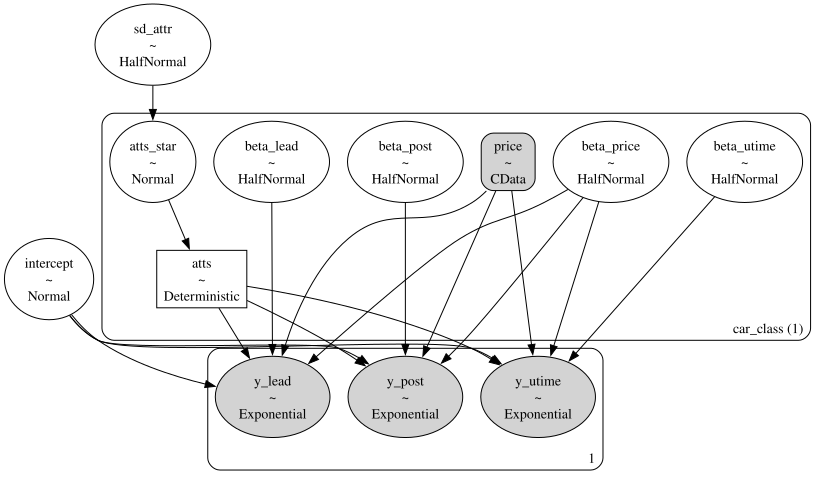

In [32]:
pm.model_to_graphviz(model)